# Problem - 1

Train a DC GAN (with an architecture of your choice) on the given data
with the usual GAN loss. Plot the loss curves for the Generator and
Discriminator losses.

In [3]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import torchvision.datasets as datasets
import numpy as np
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import matplotlib.animation as animation
from IPython.display import HTML
%matplotlib inline
seed = 42
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)



In [4]:
data_dir = "Animals_data"  
# data_dir = "butterfly_images"

ngpu = 1 #number of gpu available
img_size = 128

batch_size = 128

z=100 #latent space size

workers = 4 #number of workers for dataloader

gf = 64 #generator filter size
df = 64 #discriminator filter size

lr = 0.0002 #learning rate
beta1 = 0.5 #beta1 for adam
epochs = 5 #number of epochs to train for



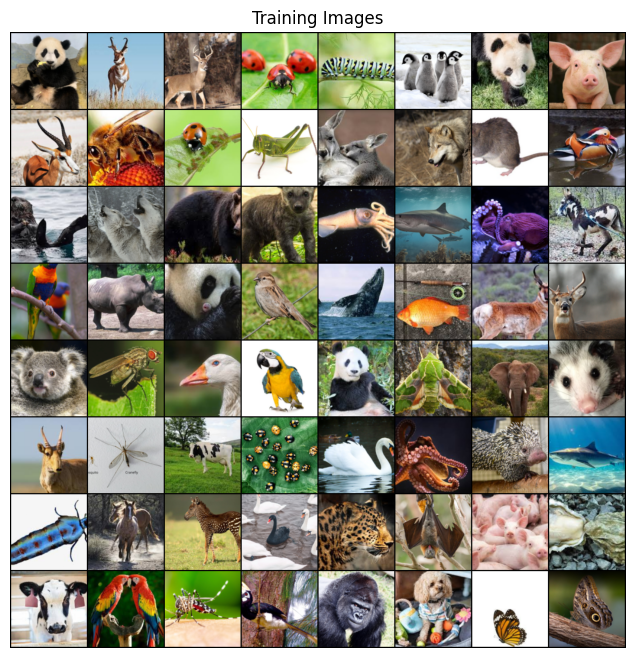

: 

In [26]:

dataset  =  datasets.ImageFolder(root=data_dir, transform=transforms.Compose([
    transforms.Resize(img_size),
    transforms.CenterCrop(img_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
]))

dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)

device = torch.device("cuda:1" if torch.cuda.is_available() else "cpu")

# plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

### Weights Initialization (According to DCGAN paper)

In [6]:
# weights initialization for the generator and discriminator
# In DC-GAN, the authors specify that all model weights shall be randomly initialized from a Normal distribution with mean=0, stdev=0.02. Using the same 
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
        

## Generator Model

In [7]:
# Generator
class Generator(nn.Module):
    def __init__(self): 
        super(Generator, self).__init__()  
        self.gen = nn.Sequential(
            nn.ConvTranspose2d(in_channels=z, out_channels=gf*16, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(gf*16),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=gf*16, out_channels=gf*8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(gf*8),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=gf*8, out_channels=gf*4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(gf*4),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=gf*4, out_channels=gf*2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(gf*2),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=gf*2, out_channels=gf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(gf),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=gf, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
            
        )
    def forward(self, input):
        return self.gen(input)
    
print(Generator())
            

Generator(
  (gen): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNo

In [8]:
Gen_model = Generator().to(device)

if (device.type == 'cuda') and (ngpu > 1):
    Gen_model = nn.DataParallel(Gen_model, device_ids=[0, 1])
    
Gen_model.apply(weights_init) # apply the weights_init function


Generator(
  (gen): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNo

## Discriminator Model 

In [9]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=df, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=df, out_channels=df*2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(df*2),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=df*2, out_channels=df*4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(df*4),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=df*4, out_channels=df*8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(df*8),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=df*8, out_channels=df*16, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(df*16),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=df*16, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
            
        )
    def forward(self, input, noise_variance):
        
        input = input + noise_variance*torch.randn_like(input)
        return self.disc(input)
    
print(Discriminator())

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05

In [10]:
Disc_model = Discriminator().to(device)

if (device.type == 'cuda') and (ngpu > 1):
    Disc_model = nn.DataParallel(Disc_model, device_ids=[0, 1])
    
Disc_model.apply(weights_init) # apply the weights_init function


Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05

In [9]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, z, 1, 1, device=device)

real_label = 1
fake_label = 0

disc_lr = 0.0002
gen_lr = 0.0002

optimizerD = optim.Adam(Disc_model.parameters(), lr=disc_lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(Gen_model.parameters(), lr=gen_lr, betas=(beta1, 0.999))

# optimizerD = optim.Adam(Disc_model.parameters(), lr=lr, betas=(beta1, 0.999))
# optimizerG = optim.Adam(Gen_model.parameters(), lr=lr, betas=(beta1, 0.999))



## Training

In [10]:
img_list = []
gen_losses = [] 
disc_losses = []
label_smoothing = False
noise_variance = 0
gen_updates = 1
disc_updates = 1

In [11]:
iters = 0
num_epochs = 300
print("Starting Training Loop...")

for epoch in range(num_epochs):
    
    for i,data in enumerate(dataloader, 0):
       
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        
        
            
        # update Disc model : maximize log(D(x)) + log(1 - D(G(z)))
        Disc_model.zero_grad()
        label = torch.full((b_size,), real_label, device=device, dtype=torch.float)
        output = Disc_model(real_cpu, noise_variance).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()
        
        noise = torch.randn(b_size, z, 1, 1, device=device)
        fake = Gen_model(noise)
        label.fill_(fake_label)
        output = Disc_model(fake.detach(), noise_variance).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()
        
        disc_losses.append(errD.item())
        
    
            
        # update Gen model : maximize log(D(G(z)))
        Gen_model.zero_grad()
        label.fill_(real_label)
        output = Disc_model(fake, noise_variance).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        gen_losses.append(errG.item())
            
    
        if i % 10 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                    % (epoch, num_epochs, i, len(dataloader),
                        errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            
        if (iters)%500 == 0 or (i == len(dataloader)-1) or (epoch == num_epochs-1):
            with torch.no_grad():
                fake = Gen_model(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            plt.imsave(f"generated_butterfly_images/{epoch}_{iters}.png", img_list[-1].numpy().transpose((1,2,0)))
            
            
        iters += 1
        
    if epoch%25 == 0:
        torch.save(Gen_model.state_dict(), f"models/gen_{epoch}.pth")
        torch.save(Disc_model.state_dict(), f"models/disc_{epoch}.pth")
        
        
       
            
            

Starting Training Loop...
[0/300][0/43]	Loss_D: 1.9622	Loss_G: 18.9857	D(x): 0.6348	D(G(z)): 0.6559 / 0.0000
[0/300][10/43]	Loss_D: 1.2904	Loss_G: 18.4004	D(x): 0.5171	D(G(z)): 0.0007 / 0.0000
[0/300][20/43]	Loss_D: 0.0067	Loss_G: 16.2778	D(x): 0.9936	D(G(z)): 0.0000 / 0.0000
[0/300][30/43]	Loss_D: 0.0239	Loss_G: 41.9916	D(x): 0.9785	D(G(z)): 0.0000 / 0.0000
[0/300][40/43]	Loss_D: 5.6314	Loss_G: 43.0420	D(x): 0.9968	D(G(z)): 0.9114 / 0.0000
[1/300][0/43]	Loss_D: 0.2175	Loss_G: 57.8501	D(x): 0.8919	D(G(z)): 0.0000 / 0.0000
[1/300][10/43]	Loss_D: 0.0047	Loss_G: 56.2174	D(x): 0.9955	D(G(z)): 0.0000 / 0.0000
[1/300][20/43]	Loss_D: 0.0020	Loss_G: 55.7680	D(x): 0.9980	D(G(z)): 0.0000 / 0.0000
[1/300][30/43]	Loss_D: 0.0011	Loss_G: 55.1798	D(x): 0.9989	D(G(z)): 0.0000 / 0.0000
[1/300][40/43]	Loss_D: 0.0007	Loss_G: 55.7089	D(x): 0.9993	D(G(z)): 0.0000 / 0.0000
[2/300][0/43]	Loss_D: 0.0004	Loss_G: 55.4249	D(x): 0.9996	D(G(z)): 0.0000 / 0.0000
[2/300][10/43]	Loss_D: 0.0010	Loss_G: 54.7066	D(x): 0

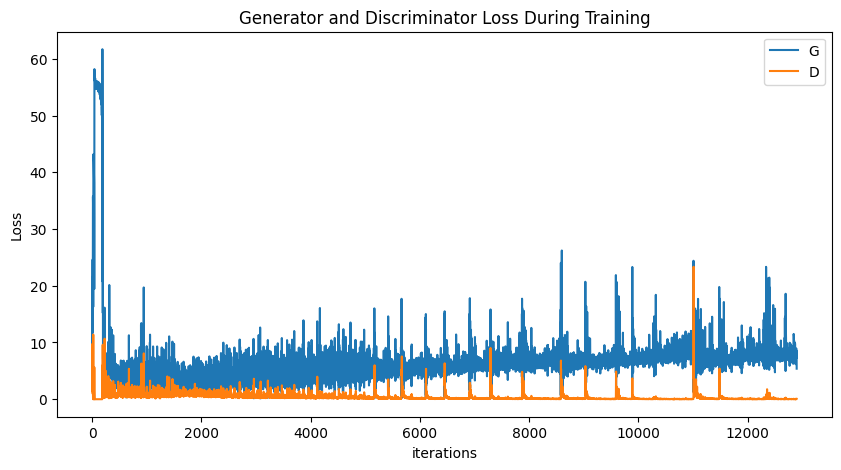

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_losses,label="G")
plt.plot(disc_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


Animation size has reached 21064767 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


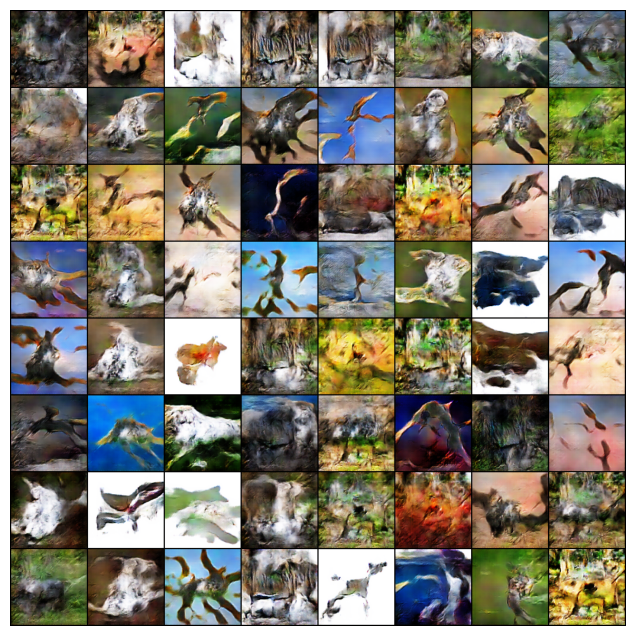

In [13]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())


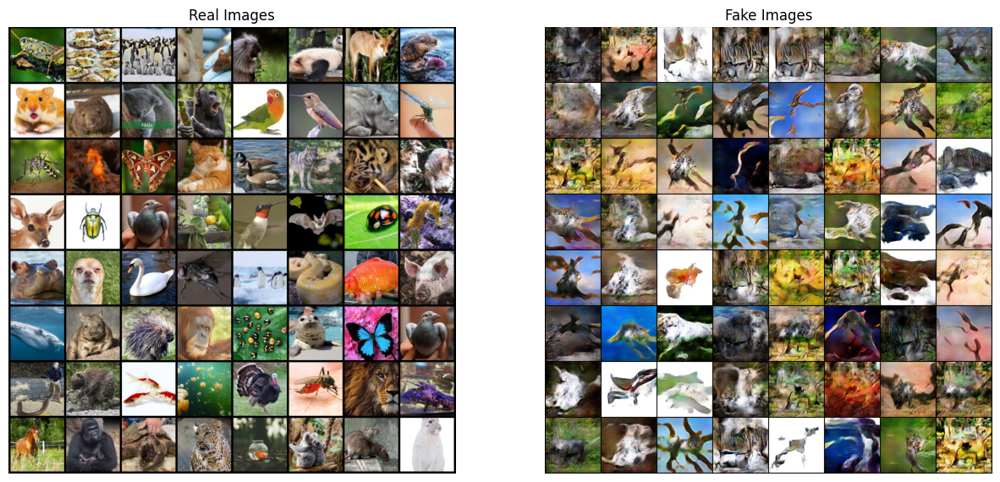

In [14]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [11]:
from torchvision.utils import make_grid, save_image
import torch_fidelity
torch_fidelity.defaults.DEFAULTS['samples_find_deep'] = True
device = 'cuda:0'
netG = Generator().to(device)

num_images = 1000
batch_size = 100
num_batches = num_images//batch_size
fids = {}

for epoch in range(0,300,25):
    print(epoch)
    netG.load_state_dict(torch.load(f'models/gen_{epoch}.pth'))
    for i in range(num_batches):
        noise = torch.randn(batch_size, z, 1, 1, device=device)
        gen_samples = netG(noise).detach().cpu()
        for id, sample in enumerate(gen_samples):
            sample = sample.view(3,
                                128,
                                128)
            sample = (sample/2.0 + 0.5).clip(0,1)

            save_image(sample, os.path.join('gen', 'sample_{}.jpg'.format(i*batch_size + id)))

    metrics_dict = torch_fidelity.calculate_metrics(
    input1='gen', 
    input2='compare_animals', 
    cuda=True, 
    isc=True, 
    fid=True, 
    kid=True, 
    prc=True, 
    verbose=False,
    )
    fids[epoch] = metrics_dict['frechet_inception_distance']


0


/tmp/ipykernel_2483408/340552618.py:14: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  netG.load_state_dict(torch.load(f'models/gen_{epoch}.pth'))


/raid/home/gnaneswaras/.local/lib/python3.8/site-packages/torch_fidelity/datasets.py:16: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  img = torch.ByteTensor(torch.ByteStorage.from_buffer(img.tobytes())).view(height, width, 3)


25
50
75
100
125
150
175
200
225
250
275


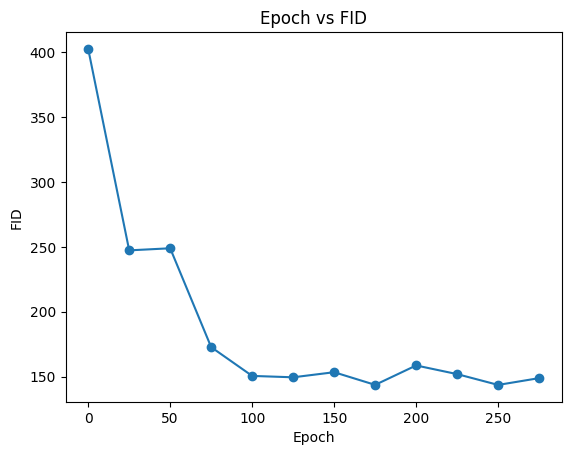

In [12]:
plt.plot(list(fids.keys()),list(fids.values()),'-o')
plt.xlabel('Epoch')
plt.ylabel('FID')
plt.title('Epoch vs FID')
plt.show()

In [ ]:
import torch_fidelity
torch_fidelity.defaults.DEFAULTS['samples_find_deep'] = True
metrics_dict = torch_fidelity.calculate_metrics(
    input1='gen', 
    input2='butterfly_images/test', 
    cuda=True, 
    isc=True, 
    fid=True, 
    kid=True, 
    prc=True, 
    verbose=False,
)

print(metrics_dict)

In [13]:
print("FID: ", metrics_dict['frechet_inception_distance'])

FID:  148.7456480184694


In [25]:
# import os
# import random
# import shutil
# from PIL import Image

# # Define the source and destination directories
# source_dir = 'Animals_data/animals'
# destination_dir = 'compare_animals'
# target_size = (128, 128)  # Define the target size for resizing

# # Ensure the destination directory exists
# os.makedirs(destination_dir, exist_ok=True)

# # Collect all image paths from the source directory
# image_paths = []
# for root, _, files in os.walk(source_dir):
#     for file in files:
#         if file.lower().endswith(('.png', '.jpg', '.jpeg')):
#             image_paths.append(os.path.join(root, file))

# # Randomly sample 1000 images
# sampled_images = random.sample(image_paths, 1000)

# # Resize and copy the sampled images to the destination directory
# for image_path in sampled_images:
#     with Image.open(image_path) as img:
#         img_resized = img.resize(target_size)
#         img_resized.save(os.path.join(destination_dir, os.path.basename(image_path)))

# print(f'Successfully copied and resized {len(sampled_images)} images to {destination_dir}')

Successfully copied and resized 1000 images to compare_animals


## Interpolation

/tmp/ipykernel_2483408/4223642883.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  netG.load_state_dict(torch.load(f'models/gen_275.pth'))


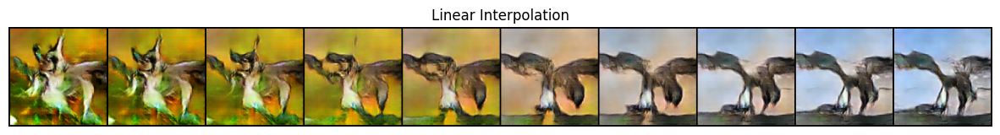

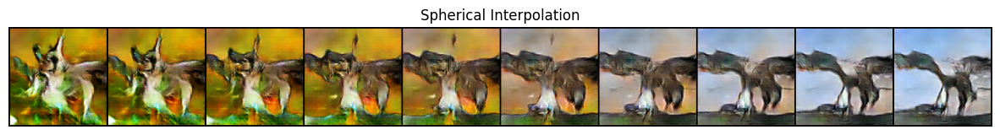

In [25]:

device = 'cuda:0'
netG = Generator().to(device)
netG.load_state_dict(torch.load(f'models/gen_275.pth'))
netG.eval()


z_dim = 100


def generate_images(latent_vectors):
    with torch.no_grad():
        images = netG(latent_vectors).cpu()
    return images

def linear_interpolation(z1, z2, steps=10):
    return [(1 - alpha) * z1 + alpha * z2 for alpha in np.linspace(0, 1, steps)]

# Function to perform spherical interpolation (non-linear)
def spherical_interpolation(z1, z2, steps=10):
    omega = np.arccos(np.dot(z1 / np.linalg.norm(z1), z2 / np.linalg.norm(z2)))
    return [torch.tensor(np.sin((1 - alpha) * omega) / np.sin(omega) * z1 + np.sin(alpha * omega) / np.sin(omega) * z2) for alpha in np.linspace(0, 1, steps)]

# Sample two random latent vectors
z1 = torch.randn(1, z_dim, 1, 1, device=device)
z2 = torch.randn(1, z_dim, 1, 1, device=device)

# Perform linear interpolation
linear_latents = torch.stack(linear_interpolation(z1, z2)).view(-1, z_dim, 1, 1)

# Perform spherical interpolation
spherical_latents = torch.stack(spherical_interpolation(z1.squeeze().cpu().numpy(), z2.squeeze().cpu().numpy())).view(-1, z_dim, 1, 1).to(device)

# Generate images from interpolated latent vectors
linear_images = generate_images(linear_latents)
spherical_images = generate_images(spherical_latents)


# Plot the images
def plot_images(images, title):
    grid = make_grid(images, nrow=10, normalize=True, scale_each=True)
    plt.figure(figsize=(15, 15))
    plt.imshow(grid.permute(1, 2, 0).numpy())
    plt.title(title)
    plt.axis('off')
    plt.show()

plot_images(linear_images, 'Linear Interpolation')
plot_images(spherical_images, 'Spherical Interpolation')
